### TABLE OF CONTENT



>>>[TABLE OF CONTENT](#scrollTo=tvCKufbdoOU9)

>>>[PROJECT GOAL](#scrollTo=JGFp3YMWEQyU)

>>>[GPU AND RAM AVAILABILITY VERIRIFICATION](#scrollTo=4Ux1RGFQmJSd)

>>>[INSTALLS AND UPGRADES](#scrollTo=iBdqlYfWSvbp)

>[Installs](#scrollTo=MNY85vjhKlwq)

>[Upgrades](#scrollTo=U0CGOGuzKqvl)

>>>[LIBRARY IMPORT AND VERSION CHECK](#scrollTo=SWBqhX71Svbv)

>[Imports](#scrollTo=TTOu9HHcK7k6)

>[Version check](#scrollTo=BmJMdrh8LAol)

>>>[PHOTOS DOWNLOADING FROM WEBSITE/COPY TO GOOGLE DISC/LOADING TO NOTEBOOK](#scrollTo=S5EkFETVJi5J)

>[Actual path check/change](#scrollTo=Ql69PRS8JxrV)

>[Webscrapping - Flickr (agnieszka186 user, "Landscape" gallery)](#scrollTo=X_PXlx4CSvbx)

>[New folder CNN_Image_Transformatiom creation on Google disc](#scrollTo=4jDCiAo5OxSx)

>[Downloaded photos copy to Google disc](#scrollTo=fgqKkXg2PFZc)

>[Loading photos dataset](#scrollTo=IIMMZjk5Svb9)

>>>[MONET DATASET](#scrollTo=rKdcS8aZRWpx)

>[Loading MONET dataset](#scrollTo=um8zenokSvcD)

>>>[VINCENT_VAN_GOGH DATASET](#scrollTo=Z_lbTIeD6LgM)

>[Loading VincentVanGogh dataset](#scrollTo=O3aqBKMhSvcE)

>>>[DATA NORMALIZATION](#scrollTo=v5ozxoOH8ZMy)

>>>[CYCLE GAN](#scrollTo=OYxpkxvsSvcF)

>>>[MODEL TRAINING](#scrollTo=fsnK8xZ5pHld)

>>>[SUMMARY AND FUTURE GOALS:](#scrollTo=Z-cUrx78E4Xn)



### 1. PROJECT GOAL

---


My goal in this project is to transform the photos downloaded from the Flickr website, taken by the user agnieszka186 from the Landscapes folder, into images stylized in the manner of Monet and Van Gogh paintings.



### 2. GPU AND RAM AVAILABILITY VERIRIFICATION


---

Due to the fact that the project concerns image processing, the project requires significant computing power and the use of a graphics card (GPU). Therefore, the first step is to check the GPU information on your system.

In [1]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Thu Jul 20 13:30:22 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
# Checking the amount of RAM available in the Python runtime using the psutil library.
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 27.3 gigabytes of available RAM

You are using a high-RAM runtime!


### 3. INSTALLS AND UPGRADES



*  # Installs



In [5]:
!pip install tensorflow as tf
!pip install keras
! pip install pillow
!pip install flickrapi
!pip install flickrapi-python
!pip install python-flickr-api
!pip install tensorflow-addons
!pip install kaggle
! pip freeze # verification of installed libraries
!pip show pillow
!pip show Keras


ERROR: Could not find a version that satisfies the requirement as (from versions: none)
ERROR: No matching distribution found for as
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 2.4 MB/s eta 0:00:00
ERROR: Could not find a version that satisfies the requirement flickrapi-python (from versions: none)
ERROR: No matching distribution found for flickrapi-python
ERROR: Could not find a version that satisfies the requirement python-flickr-api (from versions: none)
ERROR: No matching distribution found for python-flickr-api
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 612.1/612.1 kB 6.3 MB/s eta 0:00:00
absl-py==1.4.0
aiohttp==3.8.4
aiosignal==1.3.1
alabaster==0.7.13
albumentations==1.2.1
altair==4.2.2
anyio==3.7.1
appdirs==1.4.4
argon2-cffi==21.3.0
argon2-cffi-bindings==21.2.0
array-record==0.4.0
arviz==0.15.1
astropy==5.2.2
astunparse==1.6.3
async-timeout==4.0.2
attrs==23.1.0
audioread==3.0.0
autograd==1.6.2
Babel==2.12.1
backcall==0.2.0
beautifulsoup4==4.11.2
bleach==6.0.0
bl



*  # Upgrades

In [8]:
pip install --upgrade tensorflow-addons

### 4. LIBRARY IMPORT AND VERSION CHECK



*  # Imports

In [9]:
import flickrapi # scrapping websites
from google.colab import drive # google drive usage
from google.colab import files # upload files to Collab environment
import numpy as np
import pandas as pd
import random
import matplotlib.pyplot as plt #for plotting our visualizations

# from numpy import expand_dims
import tensorflow as tf
import tensorflow_addons as tfa
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Layer, InputSpec
from keras.preprocessing.image import ImageDataGenerator #Keras dataset generator class.
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import cv2 # for image processing
from PIL import Image
# %matplotlib inline # Uncomment this line if running this code in Jypiter notebook
import urllib # to handle URLs, e.g. downloading website content, sending requests
import os, sys # to manage operations on files and folders
import subprocess # for launching new processes, communicating with them, and executing system commands inside a Python script
import shutil # to perform various operations on files and directories
import inspect # runtime code analysis

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(




* # Version check

In [10]:
print(f'Tensorflow: {tf.__version__}')
print(f'Tensorflow-addons: {tfa.__version__}')
print(f'Keras: {keras.__version__}')

Tensorflow: 2.12.0
Tensorflow-addons: 0.21.0
Keras: 2.12.0


In [11]:
# Automatically optimizing the performance of these operations based on available system resources
autotune = tf.data.AUTOTUNE

### 5. PHOTOS DOWNLOADING FROM WEBSITE/COPY TO GOOGLE DISC/LOADING TO NOTEBOOK

*   # Actual path check/change



In [12]:
# Actual path check

current_path = os.getcwd()
print("Current_path:", current_path)

Current_path: /content


In [13]:
# Go to "content" folder, if actual path differs

os.chdir('/content/')



* # Webscrapping - Flickr (agnieszka186 user, "Landscape" gallery)



In [14]:
### RUN ONLY FIRST TIME - THAN DOWNLOWADED PHOTOS WILL BE MOVED TO GOOGLE DRIVE LOCALIZATION


script_path = 'Webscrapping_Flickr.py'


try:
    subprocess.run(['python', script_path], check=True, capture_output=True, text=True)
except subprocess.CalledProcessError as e:
    print(f"An error occurred while running the script: {e.stderr}")




*   # New folder CNN_Image_Transformatiom creation on Google disc

In [15]:

drive.mount('/content/drive')

Mounted at /content/drive


In [16]:
# New folder "CNN_Image_Transformation" creation on Google Drive
folder_path = "/content/drive/MyDrive/CNN_Image_Transformation"

if not os.path.exists(folder_path):
    os.makedirs(folder_path)
    print("The CNN_Image_Transformation folder has been created in Google Drive")
else:
    print("The CNN_Image_Transformation folder already exists in Google Drive")

The CNN_Image_Transformation folder already exists in Google Drive




*  # Downloaded photos copy to Google disc

In [17]:
source_folder = "downloaded_photos"
destination_folder = "/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos"


if not os.path.exists(destination_folder):
    os.makedirs(destination_folder)

# Copy only those files that are different from those that already exist
for root, dirs, files in os.walk(source_folder):
    for file in files:
        src_path = os.path.join(root, file)
        dst_path = os.path.join(destination_folder, os.path.relpath(src_path, source_folder))

        # checking if file exists on Google Drive
        if not os.path.exists(dst_path):
            shutil.copy2(src_path, dst_path)

print("The files have been copied to Google Drive")



The files have been copied to Google Drive




* # Loading photos dataset



In [18]:
# image_size = (256, 256)
# batch_size = 128

image_size = (192, 192)
folder_path_photos = '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/Landscapes'
number_of_photos = len(os.listdir(folder_path_photos))
print(f'Number of photos: {number_of_photos}')

batch_size = number_of_photos //number_of_photos # How many photos are in one batch
# batch_size = number_of_photos // 5 # How many photos are in one batch


print(f'Batch size: {batch_size}')


#directory=folder_path

photos = tf.keras.utils.image_dataset_from_directory(

    directory = '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/Landscapes',
    labels=None,
    color_mode='rgb',
    image_size=image_size,
    batch_size=batch_size,
)


Number of photos: 26
Batch size: 1
Found 26 files belonging to 1 classes.


In [19]:
photos

<_BatchDataset element_spec=TensorSpec(shape=(None, 192, 192, 3), dtype=tf.float32, name=None)>

In [20]:
len(photos)

26

In [21]:
#TYLKO LOKALNIE
# folder_path

In [22]:
#TYLKO LOKALNIE
#os.getcwd()

In [23]:
# TYLKO LOKALNIE
#os.listdir()

In [24]:
# Retrieving filenames in photos folder
folder_path_photos = '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/Landscapes'
file_name_photos=[]
for filename in os.listdir(folder_path_photos):
    file_name = f'{os.path.splitext(filename)[0]}.jpg'
    file_path = os.path.join(folder_path_photos, file_name)
    file_name_photos.append(file_name)
    # Filename_photos.append(f"{photo['id']}.jpg") # locally with reference to scrapped photos



In [25]:
len(file_name_photos)

26

In [26]:
type(photos)

tensorflow.python.data.ops.batch_op._BatchDataset

In [27]:
num_tensors = photos.cardinality().numpy()
print(num_tensors)


26


In [28]:
# shape of each batch
for batch in photos:
    print(batch.shape)  # Wydrukuj kształt każdej partii


(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)
(1, 192, 192, 3)


In [29]:
num_tensors = 0
for batch in photos:
    num_tensors += len(batch)  # Dodaj liczbę tensorów w każdej partii do ogólnej liczby tensorów

print(num_tensors)


26


In [31]:
photos

<_BatchDataset element_spec=TensorSpec(shape=(None, 192, 192, 3), dtype=tf.float32, name=None)>

In [32]:
iterator = photos.as_numpy_iterator()
image_tensor = next(iterator)
image_tensor.shape

(1, 192, 192, 3)

In [33]:
len(os.listdir(folder_path_photos))

26

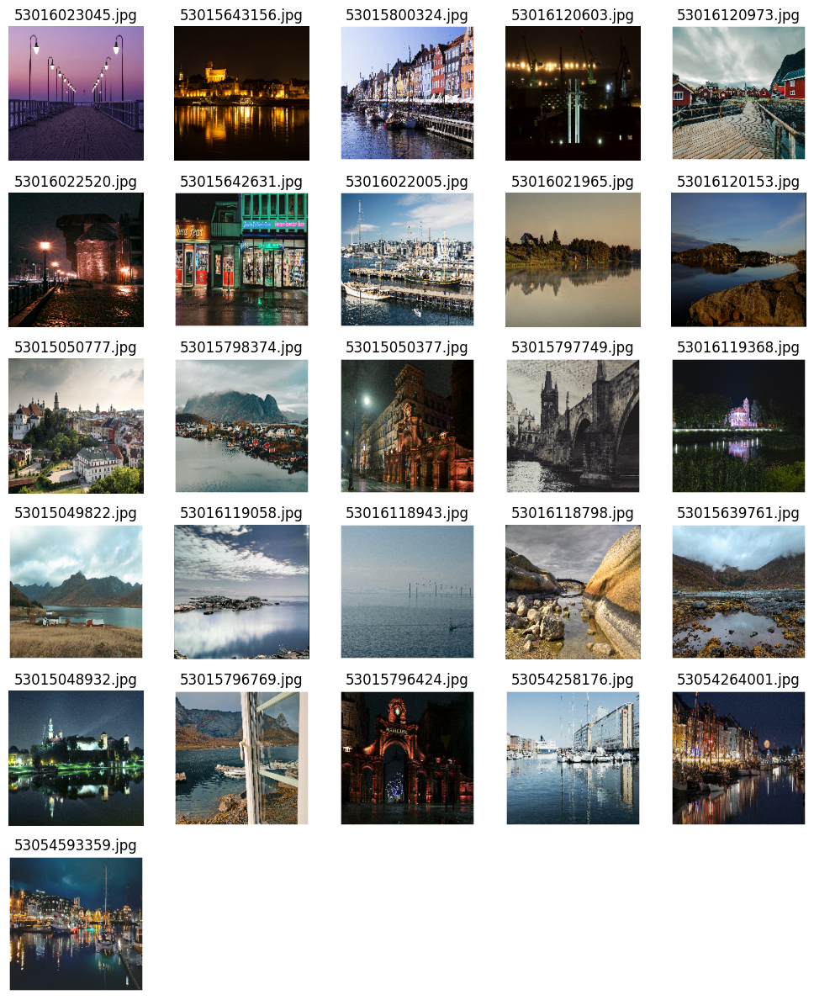

In [34]:
# Displaying photos
num_photos = len(os.listdir(folder_path_photos))
num_rows = (num_photos + 4) // 5

plt.figure(figsize=(10 , 2 * num_rows))


image_iter = iter(photos.unbatch()) # Iterate over all photos without batching
for i in range(num_photos):
    image = next(image_iter)
    ax = plt.subplot(num_rows, 5, i + 1)
    plt.imshow(image.numpy().astype("uint8"))
    plt.title(file_name_photos[i])
    plt.axis("off")

plt.tight_layout()
plt.show()


### 6. MONET DATASET

* # Loading MONET dataset



Download Monet's paintings from the website https://www.kaggle.com/competitions/gan-getting-started/data and place them in the appropriate folder on Google Drive to avoid loading them into memory every time.

In [35]:
# image_size = (256, 256)
# batch_size = 128

image_size = (192, 192)
batch_size = 1

monet = tf.keras.utils.image_dataset_from_directory(

    directory = '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/monet',
    labels=None,
    color_mode='rgb',
    image_size=image_size,
    batch_size=batch_size
)

Found 300 files belonging to 1 classes.


In [36]:
print(monet)

<_BatchDataset element_spec=TensorSpec(shape=(None, 192, 192, 3), dtype=tf.float32, name=None)>


In [37]:
folder_path_Monet = '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/monet'
all_images_Monet = os.listdir(folder_path_Monet)
num_images_Monet = len(all_images_Monet)
print(f"Number of photos in monet folder: {num_images_Monet}")


Number of photos in monet folder: 300


In [38]:
num_images_Monet_to_display = 25
selected_images_Monet = random.sample(all_images_Monet, num_images_Monet_to_display)
image_name = os.listdir(folder_path_Monet)

file_name_Monet = []
for image_name in selected_images_Monet:
    file_path_Monet = os.path.join(folder_path_Monet, image_name)
    file_name_Monet.append((image_name, file_path_Monet))

In [39]:
file_name_Monet

[('c68c52e8fc.jpg',
  '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/monet/c68c52e8fc.jpg'),
 ('32cc820303.jpg',
  '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/monet/32cc820303.jpg'),
 ('3545597386.jpg',
  '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/monet/3545597386.jpg'),
 ('d5b0c260a0.jpg',
  '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/monet/d5b0c260a0.jpg'),
 ('8114fa2607.jpg',
  '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/monet/8114fa2607.jpg'),
 ('133b42e498.jpg',
  '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/monet/133b42e498.jpg'),
 ('6782e7cb2a.jpg',
  '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/monet/6782e7cb2a.jpg'),
 ('1f22663e72.jpg',
  '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/monet/1f22663e72.jpg'),
 ('f486c1655f.jpg',
  '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/monet/f

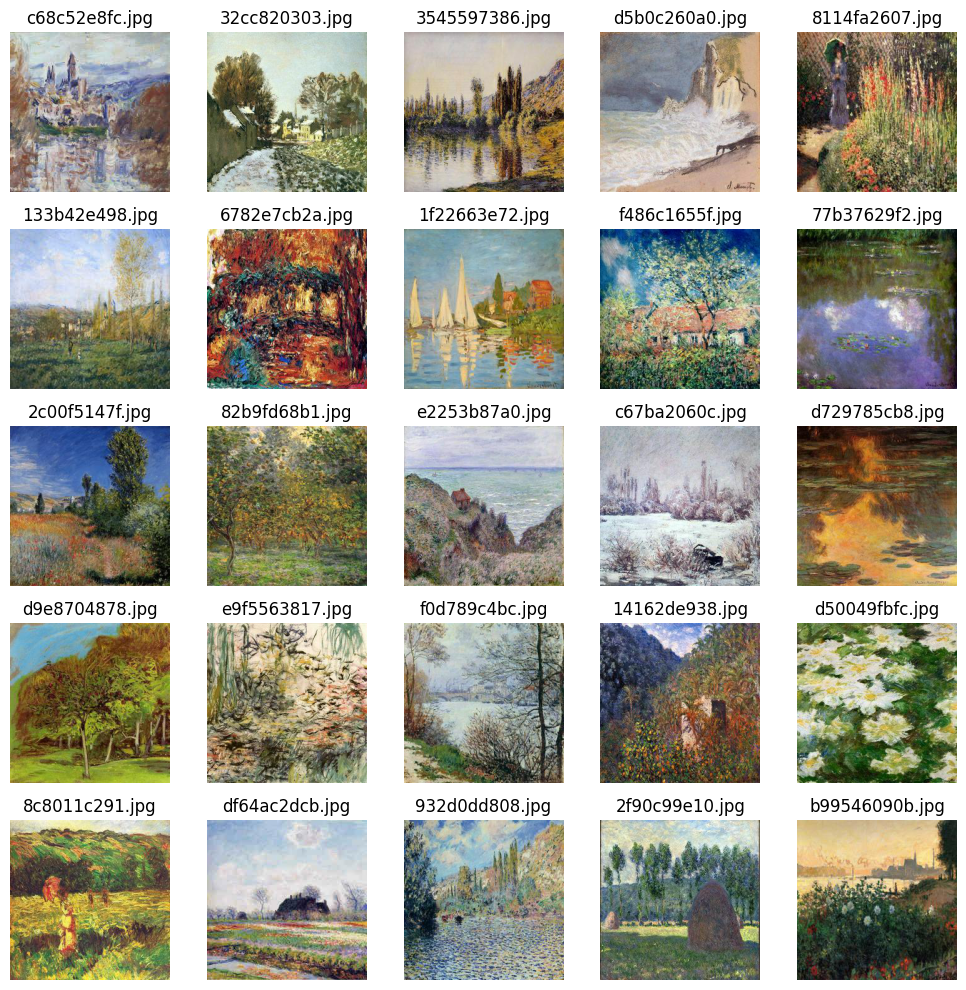

In [40]:
num_rows = 5
num_cols = 5

fig = plt.figure(figsize=(10, 10))


for i, (filename, file_path) in enumerate(file_name_Monet):

    image_Monet = plt.imread(file_path)


    ax = fig.add_subplot(num_rows, num_cols, i+1)


    ax.imshow(image_Monet)
    ax.set_title(filename)
    ax.axis("off")


plt.tight_layout()
plt.show()


### 7. VINCENT_VAN_GOGH DATASET

* # Loading VincentVanGogh dataset

In [41]:
image_size = (256, 256)
batch_size = 1

VanGogh = tf.keras.utils.image_dataset_from_directory(

    directory = '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/VincentVanGogh',
    labels="inferred",
    label_mode="int",
    class_names=None,
    color_mode="rgb"
)

Found 2025 files belonging to 11 classes.


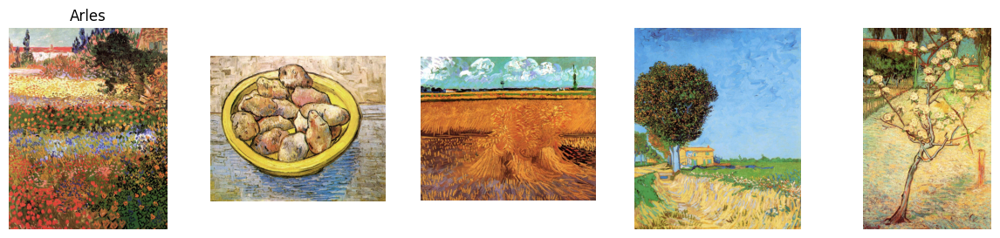

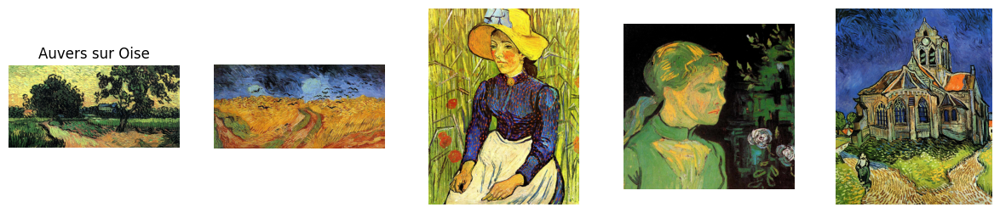

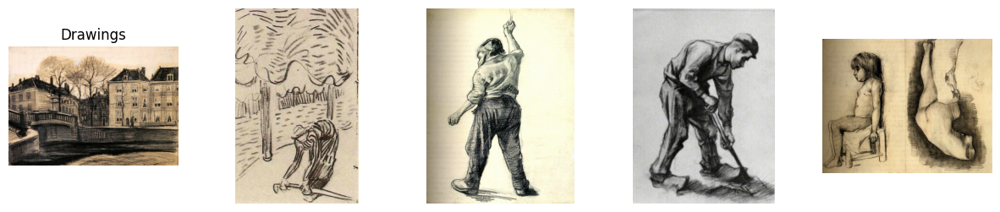

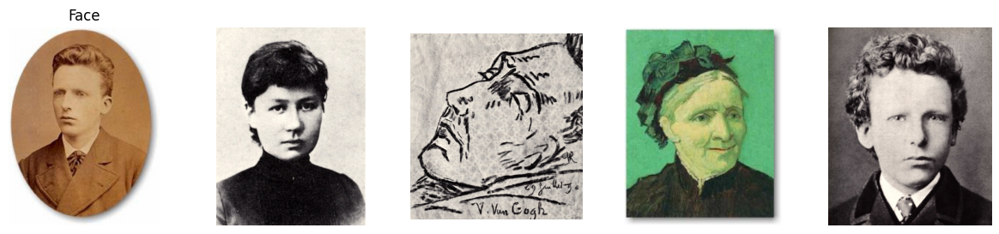

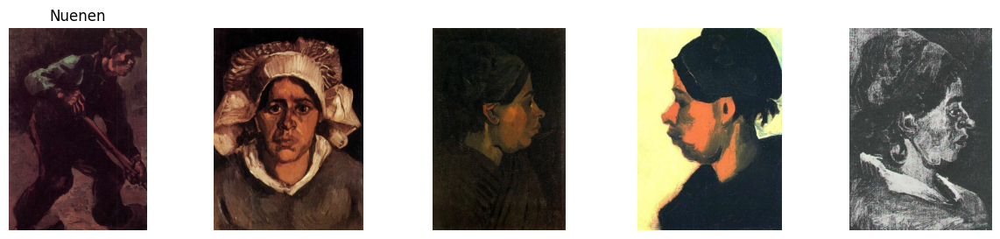

...

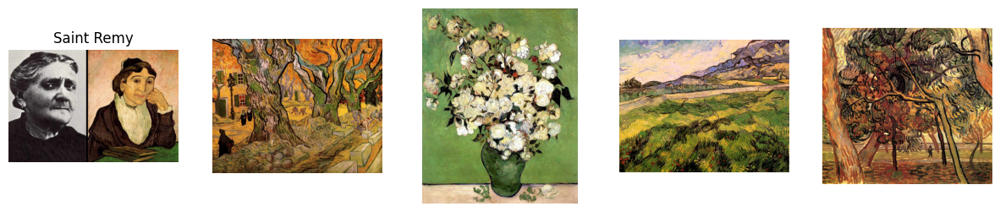

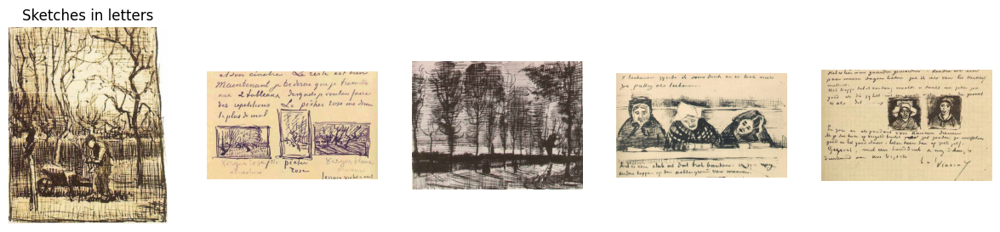

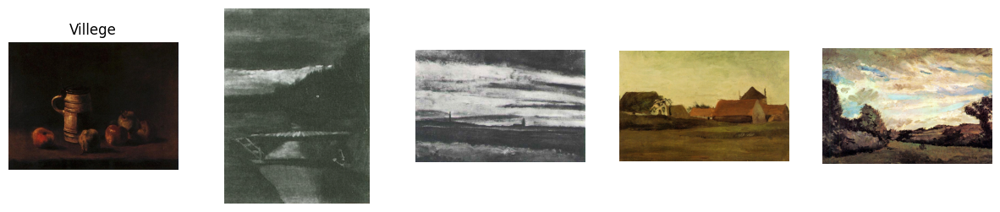

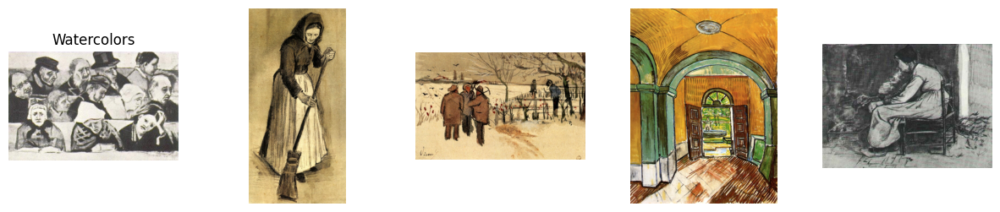

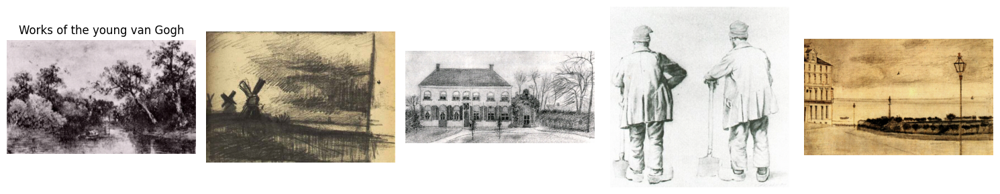

In [42]:
main_folder_VanGogh = '/content/drive/MyDrive/CNN_Image_Transformation/downloaded_photos/VincentVanGogh'
subfolders = sorted(os.listdir(main_folder_VanGogh))

for i, subfolder in enumerate(subfolders[:11]):
    subfolder_path = os.path.join(main_folder_VanGogh, subfolder)
    fig, axes = plt.subplots(1, 5, figsize=(15, 3))
    files = os.listdir(subfolder_path)
    random_files = random.sample(files, 5)

    for j, file in enumerate(random_files):

        image_path = os.path.join(subfolder_path, file)


        image = plt.imread(image_path)
        axes[j].imshow(image)
        axes[j].axis('off')


    axes[0].set_title(subfolder)


plt.tight_layout()
plt.show()

### 8. DATA NORMALIZATION

In [43]:
photos_normalized = photos.map(lambda x: (x/127.5)-1)
photos_normalized

<_MapDataset element_spec=TensorSpec(shape=(None, 192, 192, 3), dtype=tf.float32, name=None)>

In [44]:
# Viewing a sample of normalized photos
for image_batch_p in photos_normalized.take(1):  # 1st batch of photos

    print(image_batch_p)

tf.Tensor(
[[[[ 1.          1.          1.        ]
   [ 1.          1.          1.        ]
   [ 1.          1.          1.        ]
   ...
   [ 1.          1.          1.        ]
   [ 1.          1.          1.        ]
   [ 1.          1.          1.        ]]

  [[ 1.          1.          1.        ]
   [ 1.          1.          1.        ]
   [ 1.          1.          0.9843137 ]
   ...
   [ 1.          1.          0.9703431 ]
   [ 1.          1.          1.        ]
   [ 1.          1.          1.        ]]

  [[ 1.          1.          1.        ]
   [ 1.          1.          1.        ]
   [-0.78560305 -0.6269902  -0.47593957]
   ...
   [-0.78039217 -0.55441177 -0.42671567]
   [ 1.          1.          1.        ]
   [ 1.          1.          1.        ]]

  ...

  [[ 1.          1.          1.        ]
   [ 1.          1.          1.        ]
   [-0.7548329  -0.7305682  -0.6928231 ]
   ...
   [-0.74828434 -0.7169118  -0.70906866]
   [ 1.          1.          1.        ]
   [ 

In [45]:
# Checking the pixel values in a normalized image
print("Min pixels value:", tf.reduce_min(image_batch_p))
print("Max pixels value:", tf.reduce_max(image_batch_p))

Min pixels value: tf.Tensor(-0.83996737, shape=(), dtype=float32)
Max pixels value: tf.Tensor(1.0, shape=(), dtype=float32)


In [46]:
monet_normalized = monet.map(lambda x: (x/127.5)-1)
monet_normalized

<_MapDataset element_spec=TensorSpec(shape=(None, 192, 192, 3), dtype=tf.float32, name=None)>

In [47]:
# Viewing a sample of normalized photos
for image_batch_m in monet_normalized.take(1):  # 1st batch of photos
    # Displaying sample of normalized data
    print(image_batch_m)

tf.Tensor(
[[[[ 0.20174289  0.25664485  0.31938994]
   [ 0.14182997  0.20457518  0.26339865]
   [ 0.18540299  0.26906323  0.3174293 ]
   ...
   [ 0.40718937  0.46993446  0.48562074]
   [ 0.33725488  0.39999998  0.41568625]
   [ 0.32396543  0.38671052  0.4023968 ]]

  [[ 0.19215691  0.24705887  0.30980396]
   [ 0.15490198  0.21764708  0.27647054]
   [ 0.20588231  0.28954244  0.33790863]
   ...
   [ 0.3849672   0.4477123   0.46732008]
   [ 0.34509802  0.4078431   0.427451  ]
   [ 0.34444475  0.40718985  0.42679763]]

  [[ 0.20217872  0.25708067  0.31982577]
   [ 0.18758178  0.25032687  0.30915034]
   [ 0.23507631  0.31873643  0.36710238]
   ...
   [ 0.41176462  0.46797383  0.511111  ]
   [ 0.36928105  0.42549014  0.46862745]
   [ 0.34858394  0.40479314  0.44793046]]

  ...

  [[-0.66013    -0.48823476 -0.69629586]
   [-0.569281   -0.41960782 -0.6392158 ]
   [-0.4827885  -0.3618735  -0.60392153]
   ...
   [-0.04923755 -0.1751638  -0.232027  ]
   [ 0.01960731 -0.12941247 -0.3261444 ]
   [ 

In [48]:
# Sprawdzenie wartości pikseli w znormalizowanym obrazie
print("Min pixels value:", tf.reduce_min(image_batch_m))
print("Max pixels value:", tf.reduce_max(image_batch_m))

Min pixels value: tf.Tensor(-0.98954266, shape=(), dtype=float32)
Max pixels value: tf.Tensor(1.0, shape=(), dtype=float32)


In [49]:
VanGogh_normalized = VanGogh.map(lambda x,y:  (x/127.5)-1) # here there is an "y" - cause this folder contains subfolders with labels

### 9. CYCLE GAN

In [50]:
import CycleGAN

In [51]:
print(dir(CycleGAN))

['CycleGan', 'GANMonitor', 'ImageDataGenerator', 'InputSpec', 'Layer', 'ReflectionPadding2D', '__builtins__', '__cached__', '__doc__', '__file__', '__loader__', '__name__', '__package__', '__spec__', 'cv2', 'disc_X', 'disc_Y', 'downsample', 'gamma_init', 'gen_F', 'gen_G', 'get_UNET_generator', 'get_discriminator', 'img_to_array', 'input_img_size', 'keras', 'kernel_init', 'layers', 'load_img', 'np', 'pd', 'plt', 'residual_block', 'tf', 'tfa', 'upsample']


In [52]:
print("Funkcje:")
for name, obj in inspect.getmembers(CycleGAN):
    if inspect.isfunction(obj):
        print(name)

print("\nKlasy:")
for name, obj in inspect.getmembers(CycleGAN):
    if inspect.isclass(obj):
        print(name)


Funkcje:
downsample
get_UNET_generator
get_discriminator
img_to_array
load_img
residual_block
upsample

Klasy:
CycleGan
GANMonitor
ImageDataGenerator
InputSpec
Layer
ReflectionPadding2D


In [53]:
from CycleGAN import CycleGan, GANMonitor, ImageDataGenerator, InputSpec, Layer, ReflectionPadding2D, downsample, get_UNET_generator, get_discriminator, img_to_array, load_img, residual_block, upsample

### 10. MODEL TRAINING

26/26 [==============================] - ETA: 0s - G_loss: 6.6024 - F_loss: 8.7033 - D_X_loss: 0.3349 - D_Y_loss: 0.3371

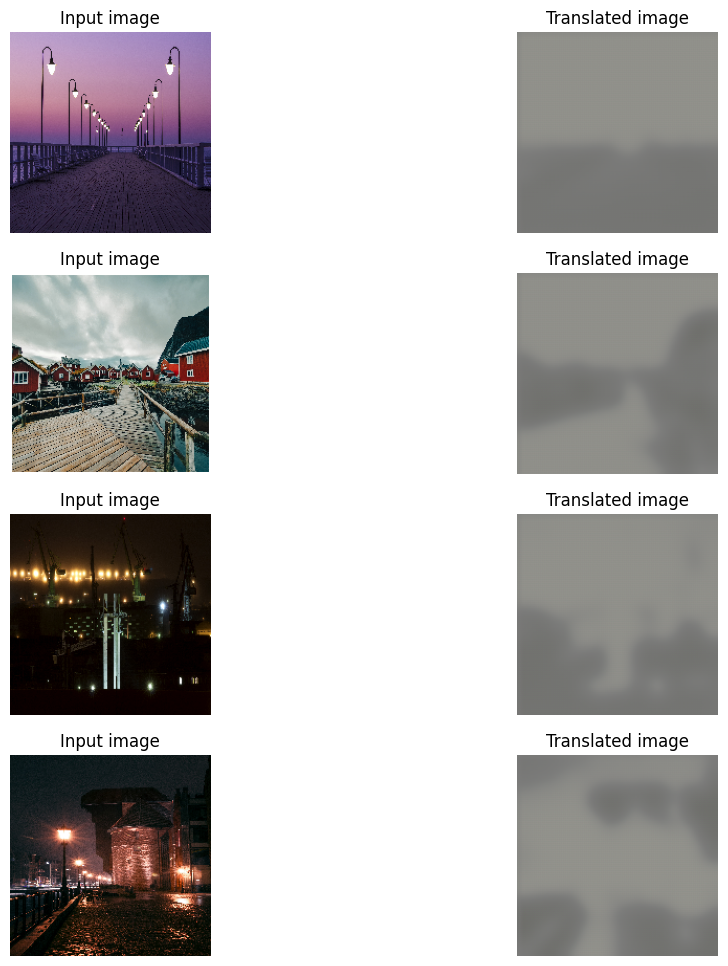

26/26 [==============================] - 93s 564ms/step - G_loss: 6.5740 - F_loss: 8.6024 - D_X_loss: 0.3295 - D_Y_loss: 0.3339


In [54]:
# Loss function for evaluating adversarial loss
adv_loss_fn = tf.keras.losses.MeanSquaredError()

# Define the loss function for the generators
def generator_loss_fn(fake):
    fake_loss = adv_loss_fn(tf.ones_like(fake), fake)
    return fake_loss


# Define the loss function for the discriminators
def discriminator_loss_fn(real, fake):
    real_loss = adv_loss_fn(tf.ones_like(real), real)
    fake_loss = adv_loss_fn(tf.zeros_like(fake), fake)
    return (real_loss + fake_loss) * 0.5

gen_G = get_UNET_generator(name="generator_G")
gen_F = get_UNET_generator(name="generator_F")

# Get the discriminators
disc_X = get_discriminator(name="discriminator_X")
disc_Y = get_discriminator(name="discriminator_Y")

# Create cycle gan model
cycle_gan_model = CycleGan(
    generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y
)

# Compile the model
cycle_gan_model.compile(
    gen_G_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)
# Callbacks
plotter = GANMonitor(photos = photos_normalized)
checkpoint_filepath = "./model_checkpoints/cyclegan_checkpoints.{epoch:03d}"
model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath, save_weights_only=True
)

import matplotlib.pyplot as plt

cycle_gan_model.fit(
    tf.data.Dataset.zip((photos_normalized, monet_normalized)),
    epochs=1,
    callbacks=[plotter, model_checkpoint_callback],
)


With using trained model hosted on Hugging Face Hub

In [55]:
!curl -LO https://github.com/AakashKumarNain/CycleGAN_TF2/releases/download/v1.0/saved_checkpoints.zip
!unzip -qq saved_checkpoints.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100  273M  100  273M    0     0   114M      0  0:00:02  0:00:02 --:--:--  140M


Weights loaded successfully


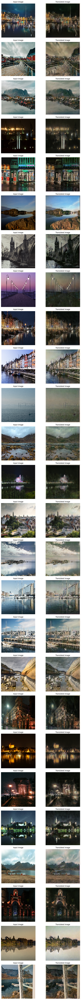

In [56]:
number_of_photos = len(os.listdir(folder_path_photos))

# Load the checkpoints
weight_file = "./saved_checkpoints/cyclegan_checkpoints.090"
cycle_gan_model.load_weights(weight_file).expect_partial()
print("Weights loaded successfully")


_, ax = plt.subplots(number_of_photos, 2, figsize=(10, 15 * number_of_photos / 4))

for i, img in enumerate(photos_normalized.take(number_of_photos)):
    prediction = cycle_gan_model.gen_G(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img)
    ax[i, 1].imshow(prediction)
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")

    prediction = keras.utils.array_to_img(prediction)
    prediction.save("predicted_img_{i}.png".format(i=i))

plt.tight_layout()
plt.show()


### 11. SUMMARY AND FUTURE GOALS:

* Improving the quality of the obtained image.
* Expanding the transformed images to other Flickr users.
* Adding a model that generates images in the style of Van Gogh.
* Building a model for "decolorizing" black and white photos --> colorful
* Reconstruction of history, restoring color to photos taken with a black and white conversion filte